<a href="https://colab.research.google.com/github/Sparsh-sb/Machinery-Anomaly-Detection-using-Preventive-Maintenance/blob/main/Machinery_Anomaly_Detection_using_Preventive_Maintenance.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import datetime
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots

from sklearn.model_selection import train_test_split
from sklearn.metrics import roc_curve, auc
from sklearn.linear_model import LogisticRegression
from imblearn.over_sampling import RandomOverSampler
from sklearn.metrics import classification_report, ConfusionMatrixDisplay, accuracy_score, confusion_matrix
from sklearn.neighbors import KNeighborsClassifier
from sklearn.naive_bayes import GaussianNB,MultinomialNB, BernoulliNB
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import MinMaxScaler
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import RandomizedSearchCV
from sklearn.preprocessing import StandardScaler
from sklearn import svm
from sklearn.model_selection import GridSearchCV


import warnings
warnings.simplefilter("ignore")

In [2]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [3]:
df = pd.read_csv('/content/drive/MyDrive/MetroPT.csv')

In [4]:
df.head()

,Unnamed: 0,timestamp,TP2,TP3,H1,DV_pressure,Reservoirs,Oil_temperature,Motor_current,COMP,DV_eletric,Towers,MPG,LPS,Pressure_switch,Oil_level,Caudal_impulses
0,0,2020-02-01 00:00:00,-0.012,9.358,9.340,-0.024,9.358,53.600,0.0400,1.0,0.0,1.0,1.0,0.0,1.0,1.0,1.0
1,10,2020-02-01 00:00:10,-0.014,9.348,9.332,-0.022,9.348,53.675,0.0400,1.0,0.0,1.0,1.0,0.0,1.0,1.0,1.0
2,20,2020-02-01 00:00:19,-0.012,9.338,9.322,-0.022,9.338,53.600,0.0425,1.0,0.0,1.0,1.0,0.0,1.0,1.0,1.0
3,30,2020-02-01 00:00:29,-0.012,9.328,9.312,-0.022,9.328,53.425,0.0400,1.0,0.0,1.0,1.0,0.0,1.0,1.0,1.0
4,40,2020-02-01 00:00:39,-0.012,9.318,9.302,-0.022,9.318,53.475,0.0400,1.0,0.0,1.0,1.0,0.0,1.0,1.0,1.0


In [5]:
df.tail()

,Unnamed: 0,timestamp,TP2,TP3,H1,DV_pressure,Reservoirs,Oil_temperature,Motor_current,COMP,DV_eletric,Towers,MPG,LPS,Pressure_switch,Oil_level,Caudal_impulses
1516943,15169430,2020-09-01 03:59:10,-0.014,8.918,8.906,-0.022,8.918,59.675,0.0425,1.0,0.0,1.0,1.0,0.0,1.0,1.0,1.0
1516944,15169440,2020-09-01 03:59:20,-0.014,8.904,8.888,-0.020,8.904,59.600,0.0450,1.0,0.0,1.0,1.0,0.0,1.0,1.0,1.0
1516945,15169450,2020-09-01 03:59:30,-0.014,8.890,8.876,-0.022,8.892,59.600,0.0425,1.0,0.0,1.0,1.0,0.0,1.0,1.0,1.0
1516946,15169460,2020-09-01 03:59:40,-0.012,8.876,8.864,-0.022,8.878,59.550,0.0450,1.0,0.0,1.0,1.0,0.0,1.0,1.0,1.0
1516947,15169470,2020-09-01 03:59:50,-0.014,8.860,8.848,-0.022,8.864,59.475,0.0425,1.0,0.0,1.0,1.0,0.0,1.0,1.0,1.0


In [6]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1516948 entries, 0 to 1516947
Data columns (total 17 columns):
 #   Column           Non-Null Count    Dtype  
---  ------           --------------    -----  
 0   Unnamed: 0       1516948 non-null  int64  
 1   timestamp        1516948 non-null  object 
 2   TP2              1516948 non-null  float64
 3   TP3              1516948 non-null  float64
 4   H1               1516948 non-null  float64
 5   DV_pressure      1516948 non-null  float64
 6   Reservoirs       1516948 non-null  float64
 7   Oil_temperature  1516948 non-null  float64
 8   Motor_current    1516948 non-null  float64
 9   COMP             1516948 non-null  float64
 10  DV_eletric       1516948 non-null  float64
 11  Towers           1516948 non-null  float64
 12  MPG              1516948 non-null  float64
 13  LPS              1516948 non-null  float64
 14  Pressure_switch  1516948 non-null  float64
 15  Oil_level        1516948 non-null  float64
 16  Caudal_impulses  1

In [7]:
df.shape

(1516948, 17)

In [8]:
df.dtypes

Unnamed: 0           int64
timestamp           object
TP2                float64
TP3                float64
H1                 float64
DV_pressure        float64
Reservoirs         float64
Oil_temperature    float64
Motor_current      float64
COMP               float64
DV_eletric         float64
Towers             float64
MPG                float64
LPS                float64
Pressure_switch    float64
Oil_level          float64
Caudal_impulses    float64
dtype: object

In [9]:
df.describe().transpose()

,count,mean,std,min,25%,50%,75%,max
Unnamed: 0,1516948.0,7.584735e+06,4.379053e+06,0.000,3792367.500,7584735.000,1.137710e+07,1.516947e+07
TP2,1516948.0,1.367826e+00,3.250930e+00,-0.032,-0.014,-0.012,-1.000000e-02,1.067600e+01
TP3,1516948.0,8.984611e+00,6.390951e-01,0.730,8.492,8.960,9.492000e+00,1.030200e+01
H1,1516948.0,7.568155e+00,3.333200e+00,-0.036,8.254,8.784,9.374000e+00,1.028800e+01
DV_pressure,1516948.0,5.595619e-02,3.824015e-01,-0.032,-0.022,-0.020,-1.800000e-02,9.844000e+00
Reservoirs,1516948.0,8.985233e+00,6.383070e-01,0.712,8.494,8.960,9.492000e+00,1.030000e+01
Oil_temperature,1516948.0,6.264418e+01,6.516261e+00,15.400,57.775,62.700,6.725000e+01,8.905000e+01
Motor_current,1516948.0,2.050171e+00,2.302053e+00,0.020,0.040,0.045,3.807500e+00,9.295000e+00
COMP,1516948.0,8.369568e-01,3.694052e-01,0.000,1.000,1.000,1.000000e+00,1.000000e+00
DV_eletric,1516948.0,1.606106e-01,3.671716e-01,0.000,0.000,0.000,0.000000e+00,1.000000e+00


In [10]:
df = df.drop('Unnamed: 0', axis= 1)

In [11]:
cols=[ 'TP2', 'TP3', 'H1', 'DV_pressure', 'Reservoirs',
 'Oil_temperature','Motor_current', 'COMP', 'DV_eletric', 'Towers',
 'MPG', 'LPS',  'Pressure_switch', 'Oil_level', 'Caudal_impulses']

In [12]:
#Check the current type of timestamp
print(f"Current type of timestamp is {type(df.timestamp[0])}")

#Convert timestamp to pandas.DateTime
df['timestamp'] = df['timestamp'].apply(pd.to_datetime, format = "%Y-%m-%d %H:%M:%S")

#Re-check the type
print(f"Current type of timestamp is {type(df.timestamp[0])}")

Current type of timestamp is <class 'str'>
Current type of timestamp is <class 'pandas._libs.tslibs.timestamps.Timestamp'>


In [13]:
df.head()

,timestamp,TP2,TP3,H1,DV_pressure,Reservoirs,Oil_temperature,Motor_current,COMP,DV_eletric,Towers,MPG,LPS,Pressure_switch,Oil_level,Caudal_impulses
0,2020-02-01 00:00:00,-0.012,9.358,9.340,-0.024,9.358,53.600,0.0400,1.0,0.0,1.0,1.0,0.0,1.0,1.0,1.0
1,2020-02-01 00:00:10,-0.014,9.348,9.332,-0.022,9.348,53.675,0.0400,1.0,0.0,1.0,1.0,0.0,1.0,1.0,1.0
2,2020-02-01 00:00:19,-0.012,9.338,9.322,-0.022,9.338,53.600,0.0425,1.0,0.0,1.0,1.0,0.0,1.0,1.0,1.0
3,2020-02-01 00:00:29,-0.012,9.328,9.312,-0.022,9.328,53.425,0.0400,1.0,0.0,1.0,1.0,0.0,1.0,1.0,1.0
4,2020-02-01 00:00:39,-0.012,9.318,9.302,-0.022,9.318,53.475,0.0400,1.0,0.0,1.0,1.0,0.0,1.0,1.0,1.0


In [14]:
#Create a new column for target variable called Status, indicate the equipment has deficiencies and need to be maintained
# Status = 0; system ups and running
# Status = 1; system downs and needs recovering
labeled_data = df.copy()
labeled_data['Status'] = 0
labeled_data.head()

,timestamp,TP2,TP3,H1,DV_pressure,Reservoirs,Oil_temperature,Motor_current,COMP,DV_eletric,Towers,MPG,LPS,Pressure_switch,Oil_level,Caudal_impulses,Status
0,2020-02-01 00:00:00,-0.012,9.358,9.340,-0.024,9.358,53.600,0.0400,1.0,0.0,1.0,1.0,0.0,1.0,1.0,1.0,0
1,2020-02-01 00:00:10,-0.014,9.348,9.332,-0.022,9.348,53.675,0.0400,1.0,0.0,1.0,1.0,0.0,1.0,1.0,1.0,0
2,2020-02-01 00:00:19,-0.012,9.338,9.322,-0.022,9.338,53.600,0.0425,1.0,0.0,1.0,1.0,0.0,1.0,1.0,1.0,0
3,2020-02-01 00:00:29,-0.012,9.328,9.312,-0.022,9.328,53.425,0.0400,1.0,0.0,1.0,1.0,0.0,1.0,1.0,1.0,0
4,2020-02-01 00:00:39,-0.012,9.318,9.302,-0.022,9.318,53.475,0.0400,1.0,0.0,1.0,1.0,0.0,1.0,1.0,1.0,0


In [15]:
def to_datetime(xs):
  result = []
  format =  "%Y-%m-%d %H:%M:%S"
  for x in xs:
    result.append(pd.to_datetime(x, format = format))
  return result


failure_start_time = to_datetime(["2020-04-18 00:00:00", "2020-05-29 23:30:00", "2020-06-05 10:00:00", "2020-07-15 14:30:00"] )
failure_end_time   = to_datetime(["2020-04-18 23:59:00", "2020-05-30 06:00:00", "2020-06-07 14:30:00", "2020-07-15 19:00:00"] )

print(failure_start_time,"\n", failure_end_time[0].minute)

[Timestamp('2020-04-18 00:00:00'), Timestamp('2020-05-29 23:30:00'), Timestamp('2020-06-05 10:00:00'), Timestamp('2020-07-15 14:30:00')] 
 59


In [16]:
def in_between(x, start, end):

  start_con = x >= start
  end_con = x<= end

  inbetween_con = start_con and end_con
  if inbetween_con:
    return 1
  else:
    return 0

In [17]:
failure_indx = []
import numpy as np
for i, (start_time, end_time) in enumerate(zip(failure_start_time, failure_end_time)):
  mask = labeled_data['timestamp'].apply(in_between, start = start_time, end = end_time)
  indx = labeled_data.index[mask == True].tolist()
  failure_indx += indx


print(f" Found {len(failure_indx)} samples representing failure state")

 Found 29954 samples representing failure state


In [18]:
#Set the sample with the timestamp falled between the failure time to 1
labeled_data['Status'].iloc[failure_indx] = 1

In [19]:
#Check the number of possitive samples
print(f"We have {labeled_data['Status'][labeled_data['Status']==1].count()} positve samples" )

We have 29954 positve samples


In [20]:
print("Example of Failure state")
labeled_data[labeled_data['Status']==1].head()

Example of Failure state


,timestamp,TP2,TP3,H1,DV_pressure,Reservoirs,Oil_temperature,Motor_current,COMP,DV_eletric,Towers,MPG,LPS,Pressure_switch,Oil_level,Caudal_impulses,Status
562564,2020-04-18 00:00:01,-0.018,8.248,8.238,-0.024,8.248,49.45,0.04,1.0,0.0,1.0,1.0,0.0,1.0,1.0,1.0,1
562565,2020-04-18 00:00:13,-0.018,8.248,8.238,-0.024,8.248,49.45,0.04,1.0,0.0,1.0,1.0,0.0,1.0,1.0,1.0,1
562566,2020-04-18 00:00:24,-0.018,8.248,8.238,-0.024,8.248,49.45,0.04,1.0,0.0,1.0,1.0,0.0,1.0,1.0,1.0,1
562567,2020-04-18 00:00:36,-0.018,8.248,8.238,-0.024,8.248,49.45,0.04,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1
562568,2020-04-18 00:00:49,-0.018,8.248,8.238,-0.024,8.248,49.45,0.04,1.0,0.0,1.0,1.0,0.0,1.0,1.0,1.0,1


<Axes: xlabel='Status', ylabel='count'>

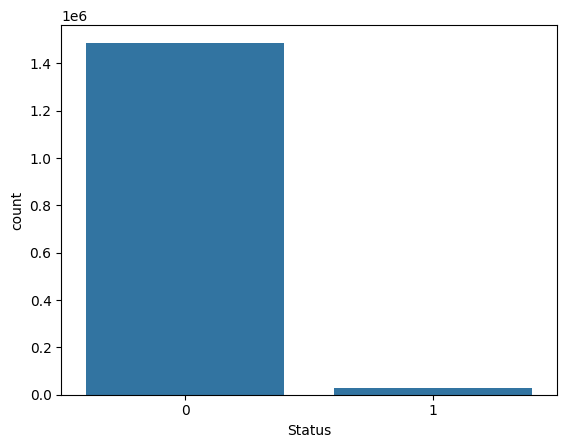

In [21]:
sns.countplot(x ='Status', data = labeled_data)

In [22]:
#Seperate Positive samples and Negative sample
pos_data = labeled_data[labeled_data['Status'] == 1]
neg_data = labeled_data[labeled_data['Status'] == 0]

#Print out the info of 2 dataset
print(f"Positive dataset\n {pos_data.info()}\n")
print(f"Negative dataset\n {neg_data.info()}\n")

<class 'pandas.core.frame.DataFrame'>
Int64Index: 29954 entries, 562564 to 1172714
Data columns (total 17 columns):
 #   Column           Non-Null Count  Dtype         
---  ------           --------------  -----         
 0   timestamp        29954 non-null  datetime64[ns]
 1   TP2              29954 non-null  float64       
 2   TP3              29954 non-null  float64       
 3   H1               29954 non-null  float64       
 4   DV_pressure      29954 non-null  float64       
 5   Reservoirs       29954 non-null  float64       
 6   Oil_temperature  29954 non-null  float64       
 7   Motor_current    29954 non-null  float64       
 8   COMP             29954 non-null  float64       
 9   DV_eletric       29954 non-null  float64       
 10  Towers           29954 non-null  float64       
 11  MPG              29954 non-null  float64       
 12  LPS              29954 non-null  float64       
 13  Pressure_switch  29954 non-null  float64       
 14  Oil_level        29954 non-null

In [23]:
n_positives = int(pos_data['Status'].count()*1.5)
sub_neg_data = neg_data.sample(n_positives, random_state = 42)
print(f"Negative dataset after subsampling {sub_neg_data.info()}")

<class 'pandas.core.frame.DataFrame'>
Int64Index: 44931 entries, 1306134 to 1403786
Data columns (total 17 columns):
 #   Column           Non-Null Count  Dtype         
---  ------           --------------  -----         
 0   timestamp        44931 non-null  datetime64[ns]
 1   TP2              44931 non-null  float64       
 2   TP3              44931 non-null  float64       
 3   H1               44931 non-null  float64       
 4   DV_pressure      44931 non-null  float64       
 5   Reservoirs       44931 non-null  float64       
 6   Oil_temperature  44931 non-null  float64       
 7   Motor_current    44931 non-null  float64       
 8   COMP             44931 non-null  float64       
 9   DV_eletric       44931 non-null  float64       
 10  Towers           44931 non-null  float64       
 11  MPG              44931 non-null  float64       
 12  LPS              44931 non-null  float64       
 13  Pressure_switch  44931 non-null  float64       
 14  Oil_level        44931 non-nul

In [24]:
merged_data = pd.concat([pos_data, sub_neg_data], axis = 0)
print(f"Merged dataset\n")
merged_data.info()

Merged dataset

<class 'pandas.core.frame.DataFrame'>
Int64Index: 74885 entries, 562564 to 1403786
Data columns (total 17 columns):
 #   Column           Non-Null Count  Dtype         
---  ------           --------------  -----         
 0   timestamp        74885 non-null  datetime64[ns]
 1   TP2              74885 non-null  float64       
 2   TP3              74885 non-null  float64       
 3   H1               74885 non-null  float64       
 4   DV_pressure      74885 non-null  float64       
 5   Reservoirs       74885 non-null  float64       
 6   Oil_temperature  74885 non-null  float64       
 7   Motor_current    74885 non-null  float64       
 8   COMP             74885 non-null  float64       
 9   DV_eletric       74885 non-null  float64       
 10  Towers           74885 non-null  float64       
 11  MPG              74885 non-null  float64       
 12  LPS              74885 non-null  float64       
 13  Pressure_switch  74885 non-null  float64       
 14  Oil_level      

<Axes: >

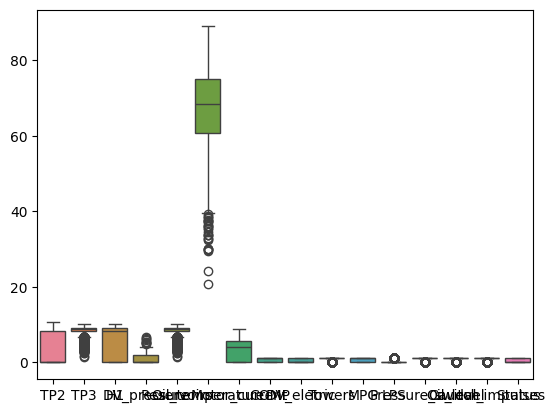

In [25]:
sns.boxplot(merged_data)

In [26]:
def investigate_outliers(data, c):
    q1 = data[c].quantile(0.25)
    q3 = data[c].quantile(0.75)
    iqr = q3 - q1
    ll = q1 - 1.5*iqr
    ul = q3 + 1.5*iqr

    num_outliers = data[data[c] < ll][c].count()  + data[data[c] > ul][c].count()
    if num_outliers>0:
        print(f"Found {num_outliers} oulier(s) for feature {c}")
    return {'col': c, 'n_outliers': num_outliers, 'll': ll, 'ul': ul, 'q1': q1, 'q3':q3}

print("\nDropping outliers ...\n")
clean_data = merged_data.copy()
for i in range(5):
  for c in clean_data.columns:
      if c not in ["Unnamed: 0","timestamp"]:
          cue = investigate_outliers(clean_data, c)
          if cue["n_outliers"] > 0 and (cue["q1"]!= cue["q3"]):
              print(f"Droping {cue['n_outliers']} from column {c}")
              clean_data = clean_data[clean_data[c]> cue["ll"]]
              clean_data = clean_data[clean_data[c]< cue["ul"]]
              print(f"{clean_data.shape[0]} samples left\n")
          elif (cue["q1"]== cue["q3"]):
              print("Skipping .. data has Q1 equals to Q3")
              print(f"{clean_data.shape[0]} rows left\n")


print("\nDropping Completed ...\n")
#Recheck data
for c in clean_data.columns:
    if c not in ["Unnamed: 0","timestamp","COMP", 'Status']:
        cue = investigate_outliers(clean_data, c)


Dropping outliers ...

Found 401 oulier(s) for feature TP3
Droping 401 from column TP3
74484 samples left

Found 9 oulier(s) for feature DV_pressure
Droping 9 from column DV_pressure
74475 samples left

Found 10 oulier(s) for feature Oil_temperature
Droping 10 from column Oil_temperature
74465 samples left

Found 17899 oulier(s) for feature Towers
Skipping .. data has Q1 equals to Q3
74465 rows left

Found 454 oulier(s) for feature LPS
Skipping .. data has Q1 equals to Q3
74465 rows left

Found 516 oulier(s) for feature Pressure_switch
Skipping .. data has Q1 equals to Q3
74465 rows left

Found 4343 oulier(s) for feature Oil_level
Skipping .. data has Q1 equals to Q3
74465 rows left

Found 2926 oulier(s) for feature Caudal_impulses
Skipping .. data has Q1 equals to Q3
74465 rows left

Found 17899 oulier(s) for feature Towers
Skipping .. data has Q1 equals to Q3
74465 rows left

Found 454 oulier(s) for feature LPS
Skipping .. data has Q1 equals to Q3
74465 rows left

Found 516 oulier(s

<Axes: >

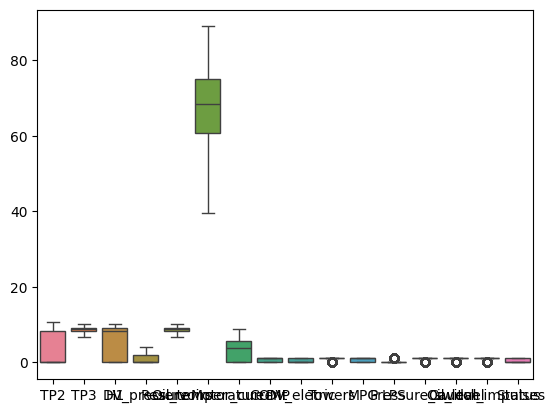

In [27]:
sns.boxplot(clean_data)

In [28]:
clean_data = clean_data.sort_values(by='timestamp')

In [29]:
#Investigate the columns with the binary values
binary_cols = ['LPS', 'Pressure_switch', 'Oil_level', 'Caudal_impulses']
#Ensure the the binary data is binary
clean_data[binary_cols] = clean_data[binary_cols].apply(np.round)

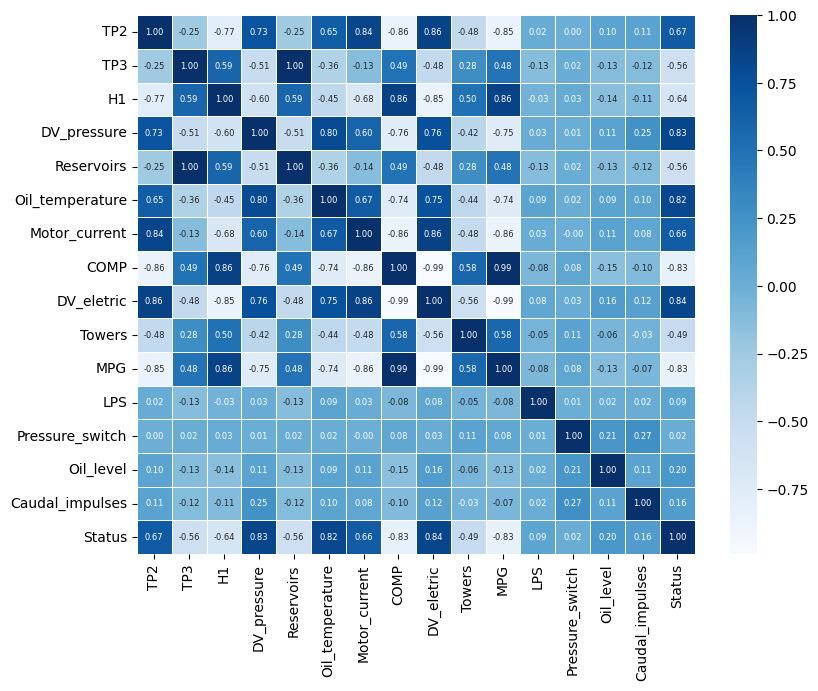

In [30]:
corr_matrix = clean_data.corr(method='spearman')
f, ax = plt.subplots(figsize=(9,7))
sns.heatmap(corr_matrix, annot=True, fmt='.2f', linewidth=0.4,
            annot_kws={"size": 6}, cmap='Blues', ax=ax)
plt.xticks(fontsize=10)
plt.yticks(fontsize=10)
plt.show()

In [31]:
for col in cols:
    fig=make_subplots(specs=[[{"secondary_y":False}]])
    fig.add_trace(go.Scatter(x=clean_data['timestamp'],y=clean_data[col],name=col),secondary_y=False,)
    fig.update_layout(autosize=False,width=850,height=300,title_text=col)
    fig.update_xaxes(title_text="index")
    fig.update_yaxes(title_text="value",secondary_y=False)
    fig.show()

In [32]:
X = clean_data.iloc[:, 2:-1]
y = clean_data.iloc[:, -1]

In [33]:
y

31         0
94         0
166        0
198        0
207        0
          ..
1516761    0
1516802    0
1516817    0
1516860    0
1516918    0
Name: Status, Length: 74465, dtype: int64

In [34]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=0)

In [35]:
lr = LogisticRegression()
lr.fit(X_train, y_train)

LogisticRegression()

In [36]:
y_pred = lr.predict(X_test)

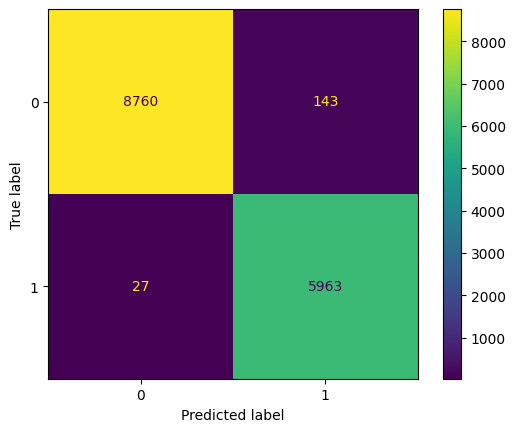

In [37]:
disp = ConfusionMatrixDisplay.from_predictions(y_test, y_pred)
plt.show()

In [38]:
accuracy_score(y_test, y_pred)

0.9885852413885718

In [39]:
print(classification_report(y_test, y_pred))

              precision    recall  f1-score   support

           0       1.00      0.98      0.99      8903
           1       0.98      1.00      0.99      5990

    accuracy                           0.99     14893
   macro avg       0.99      0.99      0.99     14893
weighted avg       0.99      0.99      0.99     14893



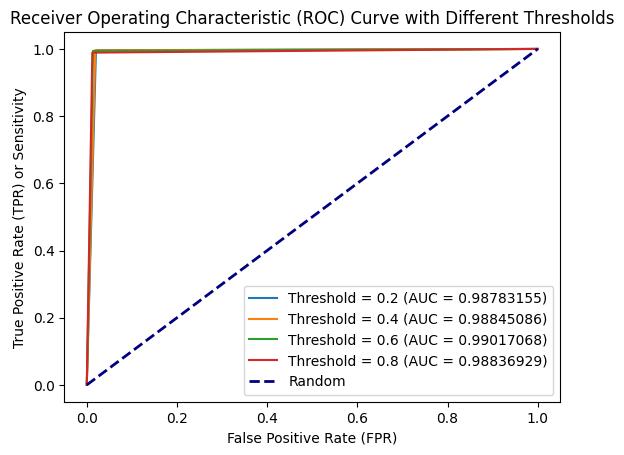

In [40]:
y_prob = lr.predict_proba(X_test)[:, 1]
for threshold in [0.2, 0.4, 0.6, 0.8]:
    y_pred_threshold = (y_prob > threshold).astype(int)
    fpr, tpr, _ = roc_curve(y_test, y_pred_threshold)
    roc_auc = auc(fpr, tpr)
    plt.plot(fpr, tpr, label='Threshold = {:.1f} (AUC = {:.8f})'.format(threshold, roc_auc))
    #print(threshold, format(roc_auc))
# Plot the "Random" line as a dashed line from (0,0) to (1,1) for reference
plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--', label='Random')

# Label axes and set the title for the plot
plt.xlabel('False Positive Rate (FPR)')
plt.ylabel('True Positive Rate (TPR) or Sensitivity')
plt.title('Receiver Operating Characteristic (ROC) Curve with Different Thresholds')
plt.legend(loc='lower right')
plt.show()

KNN

In [41]:
X = clean_data.iloc[:, 2:-1]
y = clean_data.iloc[:, -1]

In [42]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=0)


In [43]:
knn = KNeighborsClassifier()
knn.fit(X_train,y_train)

KNeighborsClassifier()

In [44]:
y_pred = knn.predict(X_test)


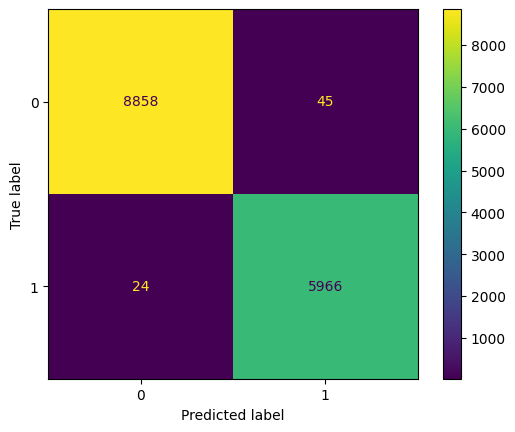

In [45]:
disp = ConfusionMatrixDisplay.from_predictions(y_test, y_pred)
plt.show()

In [46]:
accuracy_score(y_test, y_pred)


0.9953669509165379

In [47]:
print(classification_report(y_test, y_pred))


              precision    recall  f1-score   support

           0       1.00      0.99      1.00      8903
           1       0.99      1.00      0.99      5990

    accuracy                           1.00     14893
   macro avg       0.99      1.00      1.00     14893
weighted avg       1.00      1.00      1.00     14893



In [48]:
error = []
accuracy = []
# Calculating error and accuracy for K values between 1 and 40
for i in range(1,40,2):
    knn = KNeighborsClassifier(n_neighbors=i)
    knn.fit(X_train, y_train)
    pred_i = knn.predict(X_test)
    error.append(np.mean(pred_i != y_test))
    accuracy.append(accuracy_score(y_test, pred_i))

Text(0, 0.5, 'Mean Error')

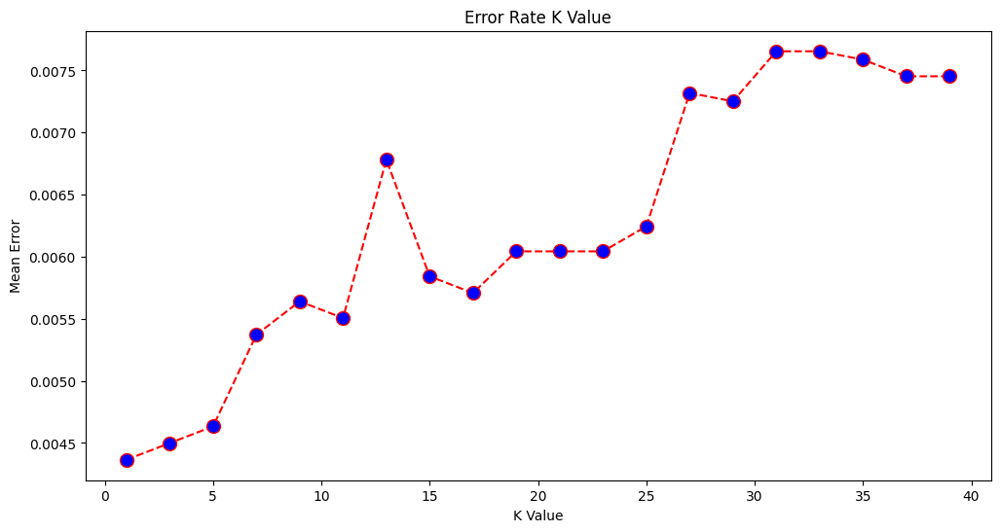

In [49]:
plt.figure(figsize=(12, 6))
plt.plot(range(1,40,2), error, color='red', linestyle='dashed', marker='o', markerfacecolor='blue', markersize=10)
plt.title('Error Rate K Value')
plt.xlabel('K Value')
plt.ylabel('Mean Error')

Text(0, 0.5, 'Accuracy')

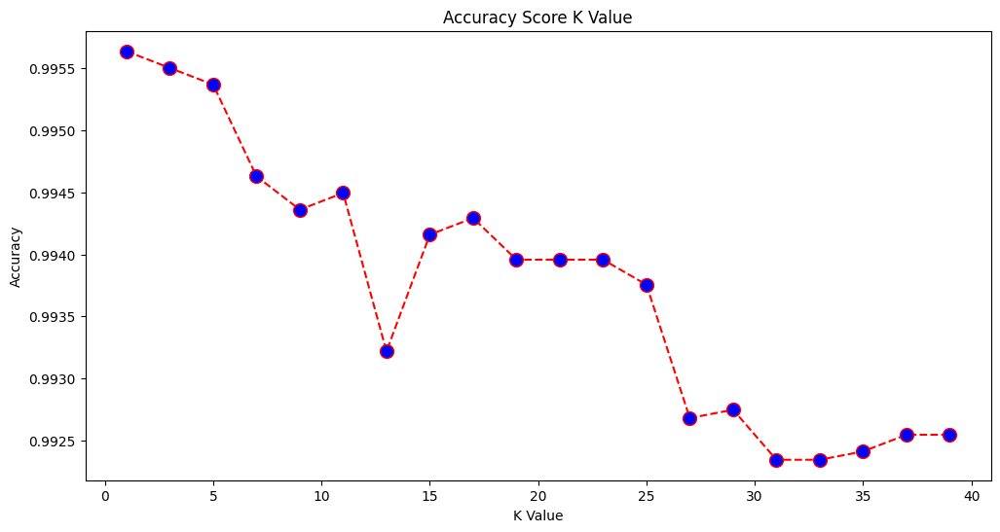

In [50]:
plt.figure(figsize=(12, 6))
plt.plot(range(1,40,2), accuracy, color='red', linestyle='dashed', marker='o', markerfacecolor='blue', markersize=10)
plt.title('Accuracy Score K Value')
plt.xlabel('K Value')
plt.ylabel('Accuracy')

In [51]:
knn = KNeighborsClassifier(n_neighbors=3)
knn.fit(X_train,y_train)
y_pred1 = knn.predict(X_test)

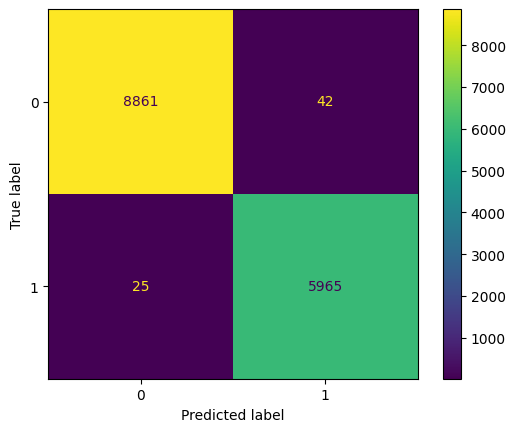

In [52]:
disp = ConfusionMatrixDisplay.from_predictions(y_test, y_pred1)
plt.show()

In [53]:
accuracy_score(y_test, y_pred1)

0.9955012421943195

In [54]:
print(classification_report(y_test, y_pred1))

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      8903
           1       0.99      1.00      0.99      5990

    accuracy                           1.00     14893
   macro avg       1.00      1.00      1.00     14893
weighted avg       1.00      1.00      1.00     14893



Naive Bayes

In [55]:
features = ['timestamp', 'TP2', 'TP3', 'H1', 'DV_pressure', 'Reservoirs',
            'Oil_temperature', 'Motor_current', 'COMP', 'DV_eletric',
            'Towers', 'MPG', 'LPS', 'Pressure_switch', 'Oil_level', 'Caudal_impulses']
target = 'Status'

In [56]:
clean_data['timestamp'] = pd.to_datetime(clean_data['timestamp'], errors='coerce')
clean_data['timestamp'] = (clean_data['timestamp'] - clean_data['timestamp'].min())  / np.timedelta64(1,'D')

In [57]:
X = clean_data[features]
y = clean_data[target]
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

In [58]:
gaussian_classifier = GaussianNB()
bernoulli_classifier = BernoulliNB()
multinomial_classifier = Pipeline([('Normalizing',MinMaxScaler()),('MultinomialNB',MultinomialNB())])

In [59]:
gaussian_classifier.fit(X_train, y_train)
multinomial_classifier.fit(X_train, y_train)
bernoulli_classifier.fit(X_train, y_train)

BernoulliNB()

In [60]:
y_pred_gaussian = gaussian_classifier.predict(X_test)
y_pred_multinomial = multinomial_classifier.predict(X_test)
y_pred_bernoulli = bernoulli_classifier.predict(X_test)

Bernoulli Naive Bayes:
              precision    recall  f1-score   support

           0       1.00      0.87      0.93      8940
           1       0.84      0.99      0.91      5953

    accuracy                           0.92     14893
   macro avg       0.92      0.93      0.92     14893
weighted avg       0.93      0.92      0.92     14893



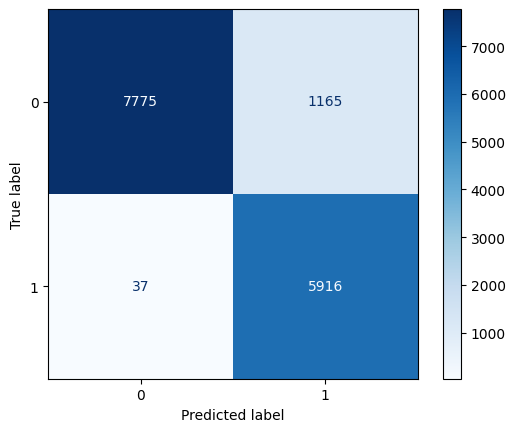

In [61]:
print("Bernoulli Naive Bayes:")
print(classification_report(y_test, y_pred_bernoulli))
conf_matrix_bernoulli = confusion_matrix(y_test, y_pred_bernoulli)
disp_bernoulli = ConfusionMatrixDisplay(conf_matrix_bernoulli, display_labels=bernoulli_classifier.classes_)
disp_bernoulli.plot(cmap='Blues', values_format='d')
plt.show()

Multinomial Naive Bayes:
              precision    recall  f1-score   support

           0       1.00      0.87      0.93      8940
           1       0.83      0.99      0.91      5953

    accuracy                           0.92     14893
   macro avg       0.91      0.93      0.92     14893
weighted avg       0.93      0.92      0.92     14893



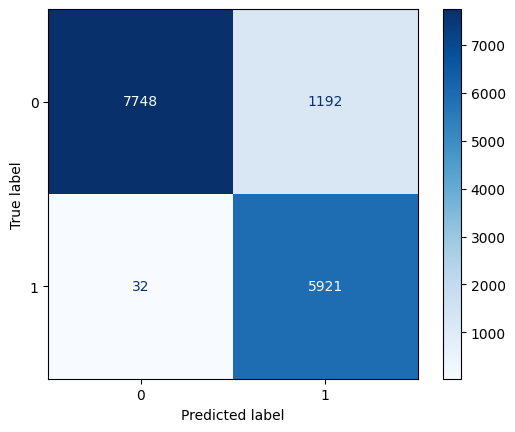

In [62]:
print("Multinomial Naive Bayes:")
print(classification_report(y_test, y_pred_multinomial))
conf_matrix_multinomial = confusion_matrix(y_test, y_pred_multinomial)
disp_multinomial = ConfusionMatrixDisplay(conf_matrix_multinomial, display_labels=multinomial_classifier.classes_)
disp_multinomial.plot(cmap='Blues', values_format='d')
plt.show()

Gaussian Naive Bayes:
              precision    recall  f1-score   support

           0       1.00      0.91      0.95      8940
           1       0.89      0.99      0.94      5953

    accuracy                           0.95     14893
   macro avg       0.94      0.95      0.95     14893
weighted avg       0.95      0.95      0.95     14893



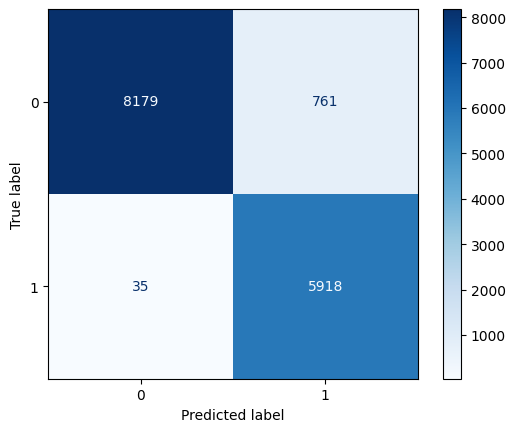

In [63]:
print("Gaussian Naive Bayes:")
print(classification_report(y_test, y_pred_gaussian))
conf_matrix_gaussian = confusion_matrix(y_test, y_pred_gaussian)
disp_gaussian = ConfusionMatrixDisplay(conf_matrix_gaussian, display_labels=gaussian_classifier.classes_)
disp_gaussian.plot(cmap='Blues', values_format='d')
plt.show()

Random Forest

In [64]:
rf=clean_data.copy()
rf = rf.drop(columns='timestamp')
label_column = 'Status'

In [65]:
rf.head()

,TP2,TP3,H1,DV_pressure,Reservoirs,Oil_temperature,Motor_current,COMP,DV_eletric,Towers,MPG,LPS,Pressure_switch,Oil_level,Caudal_impulses,Status
31,-0.012,9.040,9.026,-0.022,9.042,53.100,0.0400,1.0,0.0,1.0,1.0,0.0,1.0,1.0,1.0,0
94,-0.014,8.452,8.438,-0.022,8.450,51.425,0.0400,1.0,0.0,1.0,1.0,0.0,1.0,1.0,1.0,0
166,-0.012,9.788,9.772,-0.022,9.786,53.200,3.8425,1.0,0.0,1.0,1.0,0.0,1.0,1.0,1.0,0
198,-0.012,9.444,9.426,-0.022,9.444,53.375,0.0425,1.0,0.0,1.0,1.0,0.0,1.0,1.0,1.0,0
207,-0.014,9.350,9.334,-0.024,9.352,53.325,0.0400,1.0,0.0,1.0,1.0,0.0,1.0,1.0,1.0,0


In [66]:
X = rf.drop(label_column, axis=1)
y = rf[label_column]
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

In [67]:
print("Train set shape:", X_train.shape, y_train.shape)
print("Test set shape:", X_test.shape, y_test.shape)

Train set shape: (52125, 15) (52125,)
Test set shape: (22340, 15) (22340,)


In [68]:
model = RandomForestClassifier(random_state=42)
param_dist = {
    'n_estimators': [50, 100, 200],
    'max_depth': [10, 20, 30],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4],
    'max_features': [5, 10, 15]
}


In [69]:
random_search = RandomizedSearchCV(model, param_distributions=param_dist, n_iter=10, cv=5, scoring='accuracy', random_state=42)
random_search.fit(X_train, y_train)

RandomizedSearchCV(cv=5, estimator=RandomForestClassifier(random_state=42),
                   param_distributions={'max_depth': [10, 20, 30],
                                        'max_features': [5, 10, 15],
                                        'min_samples_leaf': [1, 2, 4],
                                        'min_samples_split': [2, 5, 10],
                                        'n_estimators': [50, 100, 200]},
                   random_state=42, scoring='accuracy')

In [70]:
cv_scores = random_search.cv_results_['mean_test_score']
hyperparameters = random_search.cv_results_['params']
best_params = random_search.best_params_

In [71]:
best_model = random_search.best_estimator_
best_model.fit(X_train, y_train)

RandomForestClassifier(max_depth=20, max_features=10, min_samples_split=5,
                       n_estimators=200, random_state=42)

In [72]:
print('Best Hyperparameters:')
print(best_params)

Best Hyperparameters:
{'n_estimators': 200, 'min_samples_split': 5, 'min_samples_leaf': 1, 'max_features': 10, 'max_depth': 20}


In [73]:
y_pred_forest = best_model.predict(X_test)
accuracy = accuracy_score(y_test, y_pred_forest)

In [74]:
print("Random Forest Classifier:")
print(classification_report(y_test, y_pred_forest))

Random Forest Classifier:
              precision    recall  f1-score   support

           0       1.00      1.00      1.00     13426
           1       1.00      1.00      1.00      8914

    accuracy                           1.00     22340
   macro avg       1.00      1.00      1.00     22340
weighted avg       1.00      1.00      1.00     22340



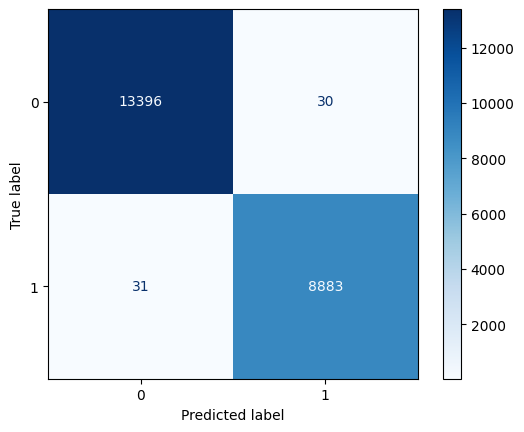

In [75]:
conf_matrix_forest = confusion_matrix(y_test, y_pred_forest)
disp_forest = ConfusionMatrixDisplay(conf_matrix_forest, display_labels=best_model.classes_)
disp_forest.plot(cmap='Blues', values_format='d')
plt.show()

Hyperparameters at Each Iteration:
Iteration 1: {'n_estimators': 50, 'min_samples_split': 10, 'min_samples_leaf': 4, 'max_features': 5, 'max_depth': 10} - Mean Accuracy: 99.53%
Iteration 2: {'n_estimators': 50, 'min_samples_split': 10, 'min_samples_leaf': 1, 'max_features': 5, 'max_depth': 10} - Mean Accuracy: 99.55%
Iteration 3: {'n_estimators': 200, 'min_samples_split': 10, 'min_samples_leaf': 2, 'max_features': 15, 'max_depth': 20} - Mean Accuracy: 99.70%
Iteration 4: {'n_estimators': 100, 'min_samples_split': 10, 'min_samples_leaf': 2, 'max_features': 15, 'max_depth': 30} - Mean Accuracy: 99.70%
Iteration 5: {'n_estimators': 100, 'min_samples_split': 5, 'min_samples_leaf': 4, 'max_features': 15, 'max_depth': 30} - Mean Accuracy: 99.69%
Iteration 6: {'n_estimators': 100, 'min_samples_split': 5, 'min_samples_leaf': 2, 'max_features': 5, 'max_depth': 30} - Mean Accuracy: 99.70%
Iteration 7: {'n_estimators': 200, 'min_samples_split': 10, 'min_samples_leaf': 4, 'max_features': 10, 'max_

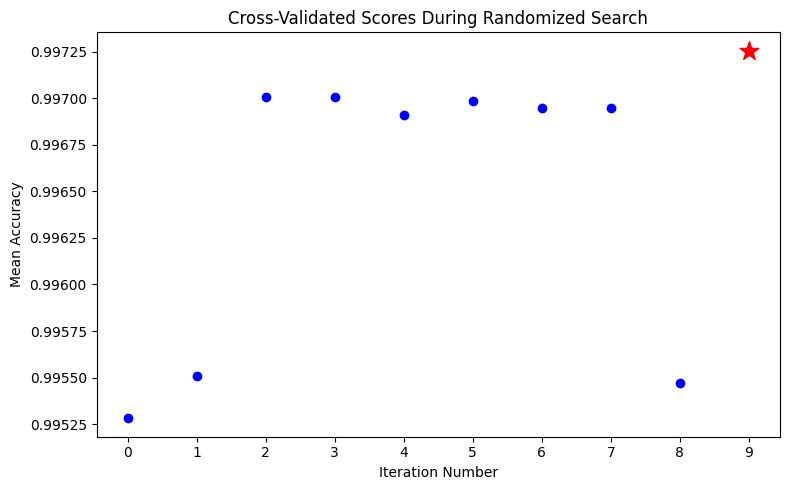

In [76]:
# Print hyperparameters outside the plot
print("Hyperparameters at Each Iteration:")
for i, params in enumerate(hyperparameters):
    print(f"Iteration {i + 1}: {params} - Mean Accuracy: {cv_scores[i]:.2%}")

# Create a plot for cross-validated scores
plt.figure(figsize=(8, 5))

# Plot the cross-validated scores
plt.scatter(range(len(cv_scores)), cv_scores, c='blue', label='Cross-validated Scores')

# Highlight the best score
best_index = random_search.best_index_
plt.scatter(best_index, cv_scores[best_index], c='red', marker='*', s=200, label='Best Score')

# Customize the plot
plt.title('Cross-Validated Scores During Randomized Search')
plt.xlabel('Iteration Number')
plt.ylabel('Mean Accuracy')

# Set x-ticks as iteration numbers
plt.xticks(range(len(cv_scores)))


plt.tight_layout()

# Show the plot
plt.show()

Best Hyperparameters:
{'n_estimators': 100, 'max_depth': 30, 'min_samples_split': 2, 'min_samples_leaf': 2, 'max_features': 10}
OOB Score: 99.73%
Random Forest Classifier:
              precision    recall  f1-score   support

           0       1.00      1.00      1.00     13426
           1       1.00      1.00      1.00      8914

    accuracy                           1.00     22340
   macro avg       1.00      1.00      1.00     22340
weighted avg       1.00      1.00      1.00     22340



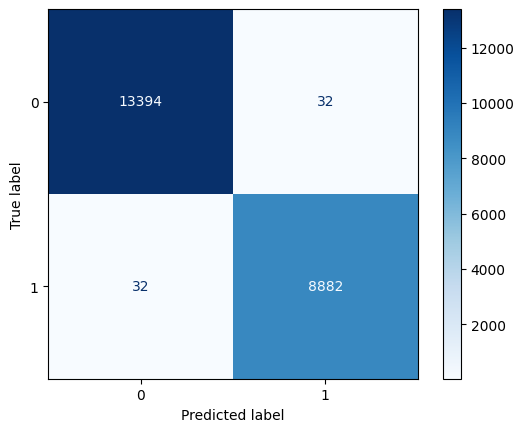

In [77]:
# Out-Of-Bag Error
param_dist = {
    'n_estimators': [50, 100, 200],
    'max_depth': [10, 20, 30],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4],
    'max_features': [5, 10, 15]
}

# Initialize a list to store results
results = []
oob_scores = []  # List to store OOB scores during grid search

# Perform randomized grid search with 10 iterations
for _ in range(10):
    params = {key: np.random.choice(values) for key, values in param_dist.items()}
    rf_model = RandomForestClassifier(oob_score=True, random_state=42, **params)
    rf_model.fit(X_train, y_train)
    oob_score = rf_model.oob_score_

    results.append({'params': params, 'oob_score': oob_score})
    oob_scores.append(oob_score)

# Find the best hyperparameters based on the highest OOB score
best_params = max(results, key=lambda x: x['oob_score'])['params']

# Print the best hyperparameters and OOB score
print('Best Hyperparameters:')
print(best_params)
print(f'OOB Score: {max(results, key=lambda x: x["oob_score"])["oob_score"]:.2%}')

# Train the final model with the best hyperparameters on the entire training set
best_model = RandomForestClassifier(oob_score=True, random_state=42, **best_params)
best_model.fit(X_train, y_train)

# Evaluate and print the results on the test set
y_pred_forest = best_model.predict(X_test)
accuracy = accuracy_score(y_test, y_pred_forest)

print("Random Forest Classifier:")
print(classification_report(y_test, y_pred_forest))

# Display confusion matrix
conf_matrix_forest = confusion_matrix(y_test, y_pred_forest)
disp_forest = ConfusionMatrixDisplay(conf_matrix_forest, display_labels=best_model.classes_)
disp_forest.plot(cmap='Blues', values_format='d')
plt.show()

Hyperparameters at Each Iteration:
Iteration 1: {'n_estimators': 200, 'max_depth': 30, 'min_samples_split': 5, 'min_samples_leaf': 1, 'max_features': 15} - OOB Score: 99.71%
Iteration 2: {'n_estimators': 50, 'max_depth': 10, 'min_samples_split': 5, 'min_samples_leaf': 2, 'max_features': 15} - OOB Score: 99.67%
Iteration 3: {'n_estimators': 100, 'max_depth': 20, 'min_samples_split': 5, 'min_samples_leaf': 1, 'max_features': 15} - OOB Score: 99.71%
Iteration 4: {'n_estimators': 200, 'max_depth': 10, 'min_samples_split': 2, 'min_samples_leaf': 2, 'max_features': 5} - OOB Score: 99.54%
Iteration 5: {'n_estimators': 100, 'max_depth': 20, 'min_samples_split': 5, 'min_samples_leaf': 1, 'max_features': 10} - OOB Score: 99.73%
Iteration 6: {'n_estimators': 100, 'max_depth': 10, 'min_samples_split': 2, 'min_samples_leaf': 1, 'max_features': 10} - OOB Score: 99.70%
Iteration 7: {'n_estimators': 100, 'max_depth': 10, 'min_samples_split': 10, 'min_samples_leaf': 4, 'max_features': 15} - OOB Score: 

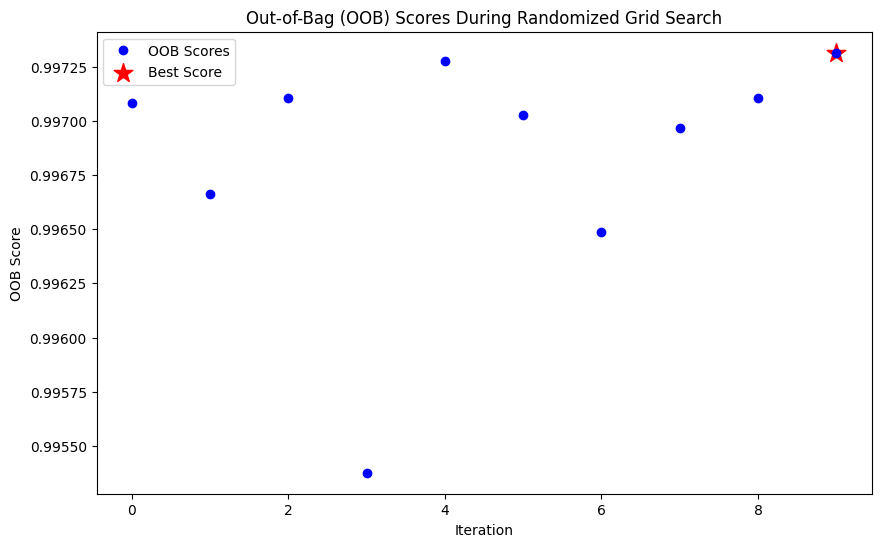

In [78]:
print("Hyperparameters at Each Iteration:")
for i, params in enumerate(results):
    print(f"Iteration {i + 1}: {params['params']} - OOB Score: {params['oob_score']:.2%}")

# Create a plot for OOB scores during grid search
plt.figure(figsize=(10, 6))

# Plot the OOB scores
plt.plot(oob_scores, marker='o', linestyle=' ', color='b', label='OOB Scores')

# Highlight the best score
best_index = np.argmax(oob_scores)
plt.scatter(best_index, oob_scores[best_index], c='red', marker='*', s=200, label='Best Score')

# Customize the plot
plt.title('Out-of-Bag (OOB) Scores During Randomized Grid Search')
plt.xlabel('Iteration')
plt.ylabel('OOB Score')
plt.legend()

# Show the plot
plt.show()

SVM

In [79]:
rf=clean_data.copy()
rf = rf.drop(columns='timestamp')
label_column = 'Status'

In [80]:
X = rf.drop(label_column, axis=1)
y = rf[label_column]


In [81]:
  #Scale the data
scaler = StandardScaler()
X = scaler.fit_transform(X)

In [82]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

In [83]:
#Train Linear SVM
svm_model = svm.SVC(kernel = 'linear')
svm_model.fit(X_train, y_train)

SVC(kernel='linear')


Classification Report:
              precision    recall  f1-score   support

           0       1.00      0.98      0.99     13426
           1       0.97      0.99      0.98      8914

    accuracy                           0.98     22340
   macro avg       0.98      0.99      0.98     22340
weighted avg       0.99      0.98      0.98     22340



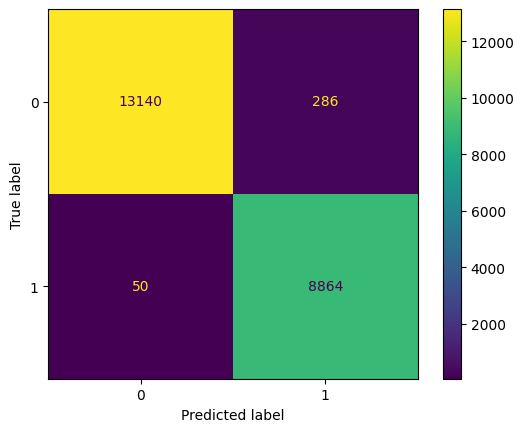

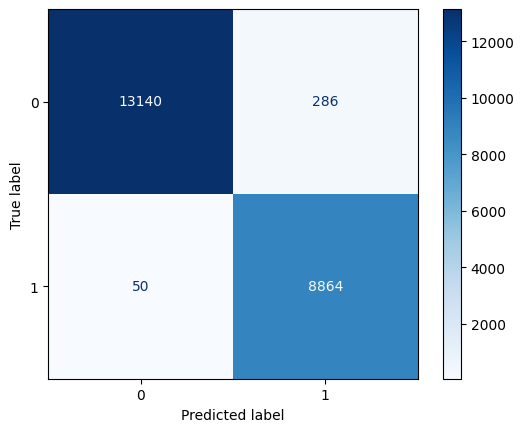

In [84]:
#Evaluate Linear SVM
y_pred = svm_model.predict(X_test)

# Print a classification report to evaluate the best model's performance
print("\nClassification Report:")
print(classification_report(y_test, y_pred))

# Display a confusion matrix for further evaluation
disp = ConfusionMatrixDisplay.from_predictions(y_test, y_pred)
disp.plot(cmap=plt.cm.Blues)

In [85]:
#Train Linear SVM
svm_model = svm.SVC(kernel = 'rbf')
svm_model.fit(X_train, y_train)

SVC()


Classification Report:
              precision    recall  f1-score   support

           0       1.00      0.99      0.99     13426
           1       0.99      0.99      0.99      8914

    accuracy                           0.99     22340
   macro avg       0.99      0.99      0.99     22340
weighted avg       0.99      0.99      0.99     22340



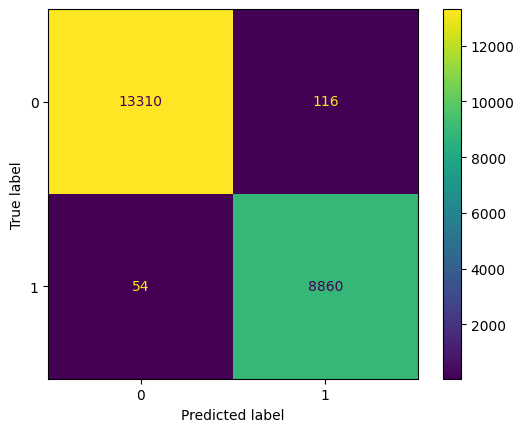

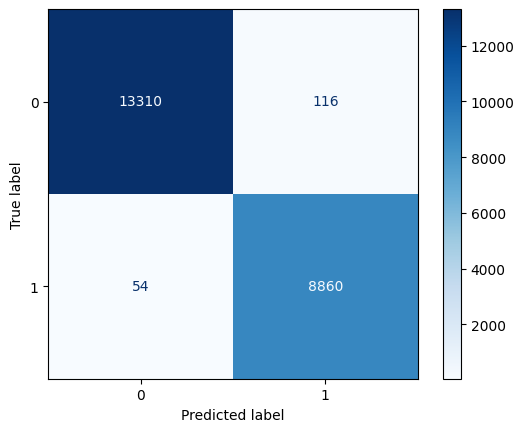

In [86]:
#Evaluate Non Linear SVM
y_pred = svm_model.predict(X_test)

# Print a classification report to evaluate the best model's performance
print("\nClassification Report:")
print(classification_report(y_test, y_pred))

# Display a confusion matrix for further evaluation
disp = ConfusionMatrixDisplay.from_predictions(y_test, y_pred)
disp.plot(cmap=plt.cm.Blues)

In [87]:
c_range = [0.01, 0.1, 1, 10 , 100, 1000]
scores     = []

In [88]:
for c in c_range:
  test_svm = svm.SVC(kernel = "linear", C= c)
  test_svm.fit(X_train, y_train)
  y_pred = test_svm.predict(X_test)
  scores.append(accuracy_score(y_test, y_pred))
  del test_svm

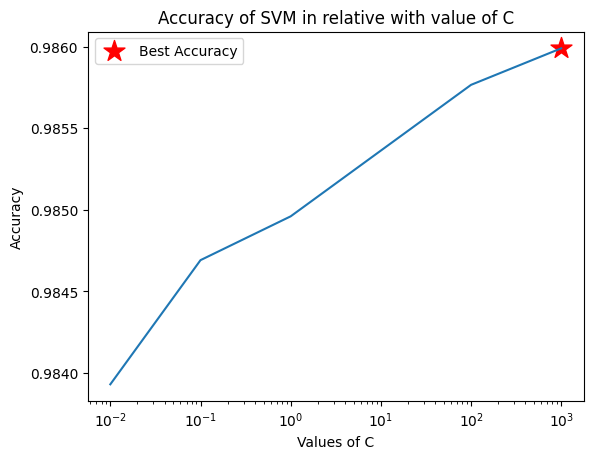

In [89]:
best_c_indx = np.argmax(scores)
best_c = c_range[best_c_indx]
best_score  = scores[best_c_indx]

plt.plot(c_range, scores)
plt.scatter(best_c, best_score, s = 250, marker = "*", color = 'r' , label = 'Best Accuracy')
plt.xlabel('Values of C')
plt.xscale('log')
plt.ylabel('Accuracy')
plt.title('Accuracy of SVM in relative with value of C' )
plt.legend()
plt.show()

In [90]:
#Train Stest_svm = svm.SVC(kernel = "linear", C= c)
svm_model = svm.SVC(C=1000)
svm_model.fit(X_train, y_train)

SVC(C=1000)


Classification Report:
              precision    recall  f1-score   support

           0       1.00      0.99      0.99     13426
           1       0.99      0.99      0.99      8914

    accuracy                           0.99     22340
   macro avg       0.99      0.99      0.99     22340
weighted avg       0.99      0.99      0.99     22340



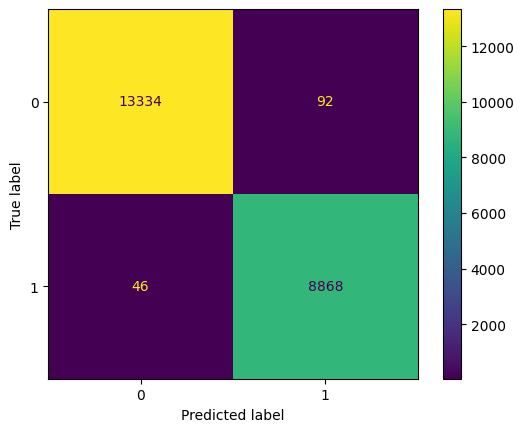

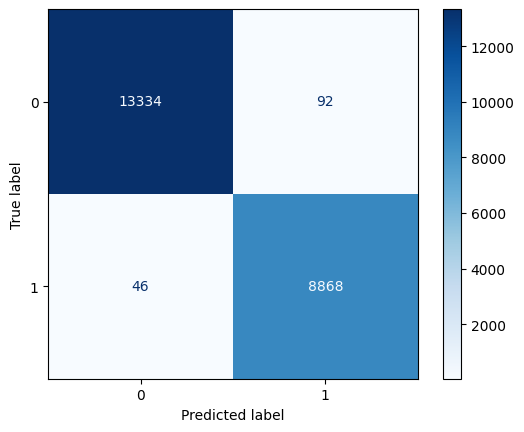

In [91]:
#Evaluate Non Linear SVM
y_pred = svm_model.predict(X_test)

# Print a classification report to evaluate the best model's performance
print("\nClassification Report:")
print(classification_report(y_test, y_pred))

# Display a confusion matrix for further evaluation
disp = ConfusionMatrixDisplay.from_predictions(y_test, y_pred)
disp.plot(cmap=plt.cm.Blues)